# baseline code 학습 후 validation 데이터 결과 확인

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
import glob
import random
import json
import cv2
from PIL import Image, ImageOps
from collections import Counter

In [2]:
img_list = glob.glob('/data/ephemeral/home/datasets/images/val/*.jpg')
len(img_list)

404

# 결과 확인

In [7]:
def print_bbox(img_path):
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img_name = img_path.split('/')[-1]
    font = cv2.FONT_HERSHEY_SIMPLEX

    with open('/data/ephemeral/home/datasets/jsons/val.json', 'r') as gt_json:
        data = json.load(gt_json)
        words = data['images'][img_name]['words']
        for word_id, word_data in words.items():
            points = np.array(word_data.get('points', []))
            points = np.round(points).astype(np.int32).reshape((-1, 2))
            cv2.polylines(img, [points], True, color=(255, 0, 0), thickness=4)
            cv2.putText(img, f'{int(word_id)}', (points[0][0], points[0][1]-10), font, 0.5, (255, 0, 0), 2)

    with open('/data/ephemeral/home/baseline_code/outputs/ocr_training/submissions/v1_val_result.json', 'r') as f:
        data = json.load(f)
        words = data['images'][img_name]['words']
        for word_id, word_data in words.items():
            points = np.array(word_data.get('points', []))
            points = np.round(points).astype(np.int32).reshape((-1, 2))
            cv2.polylines(img, [points], True, color=(0, 255, 0), thickness=2)
            cv2.putText(img, f'{int(word_id)}', (points[0][0]+30, points[0][1]-10), font, 0.5, (0, 255, 0), 2)

    cv2.putText(img, 'annotation', (50, 50), font, 1, (255, 0, 0), 3)
    cv2.putText(img, 'v1', (50, 100), font, 1, (0, 255, 0), 3)
    plt.figure(figsize=(10, 10))
    plt.title(img_name)
    plt.imshow(img)
    plt.show()
    

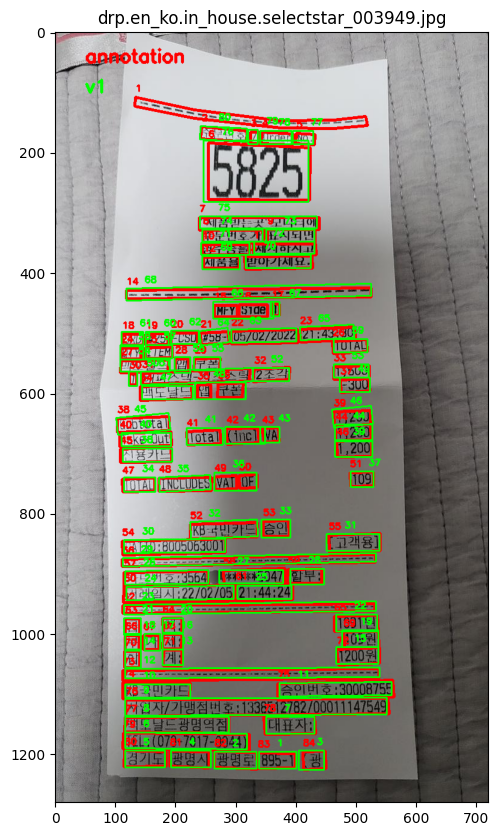

In [8]:
print_bbox(img_list[0])

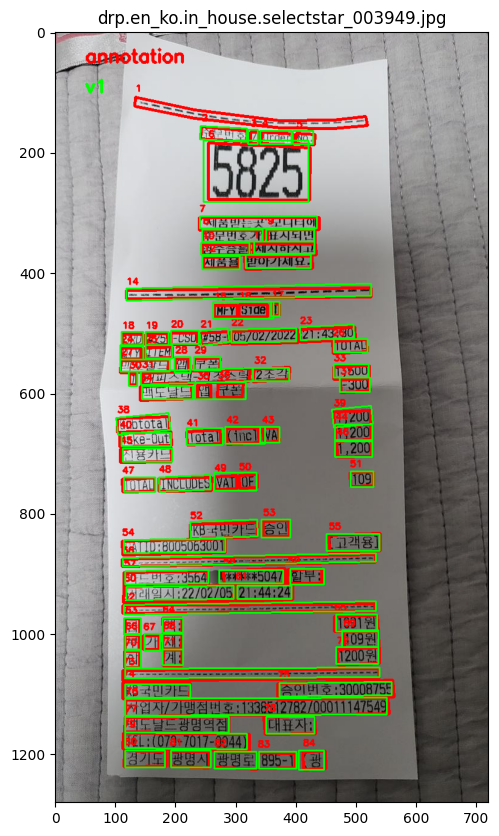

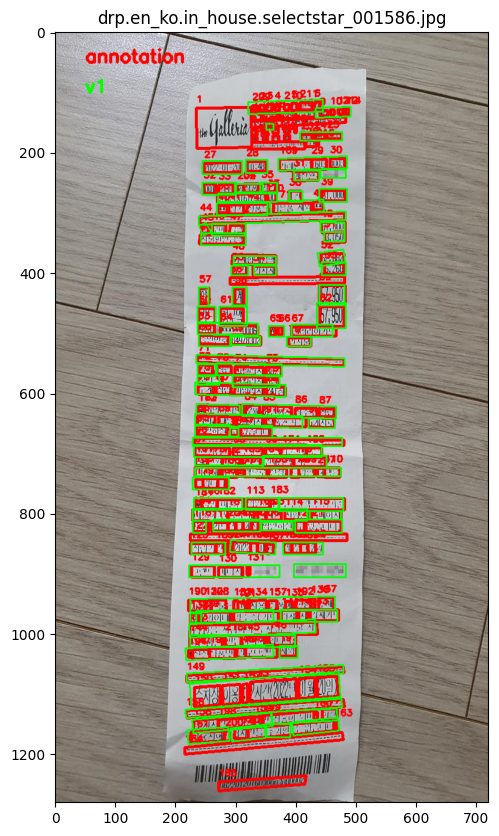

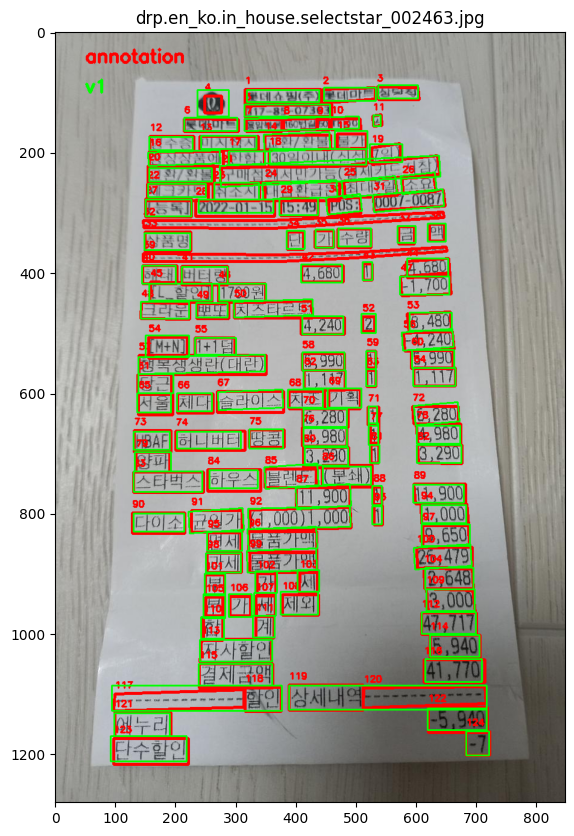

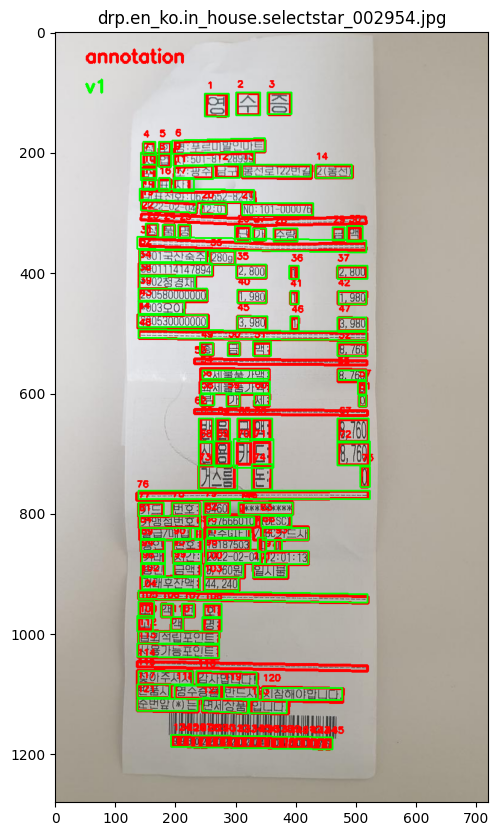

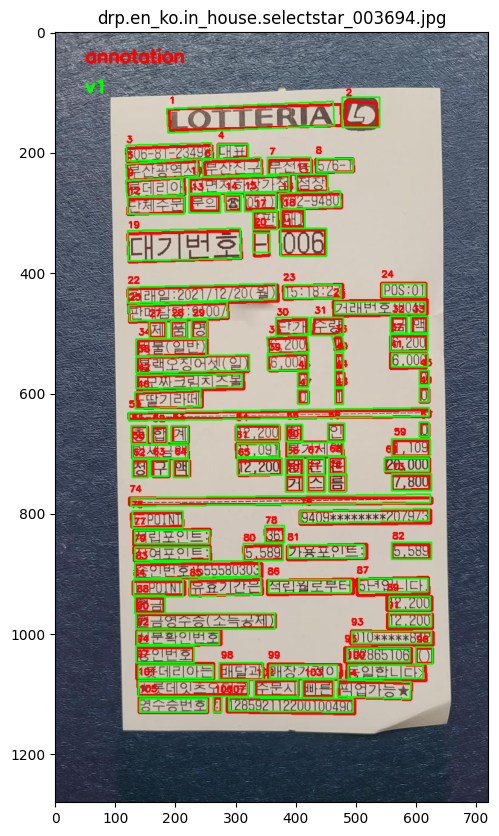

...

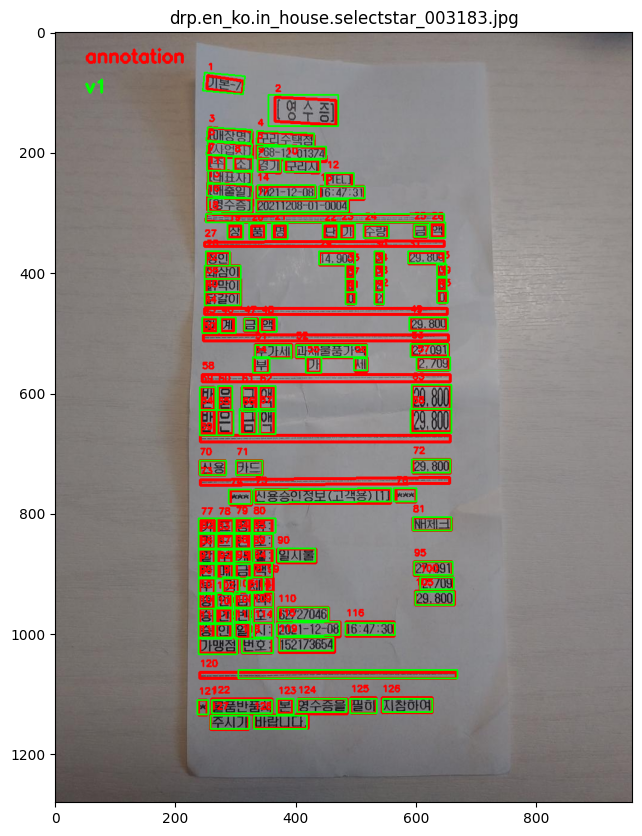

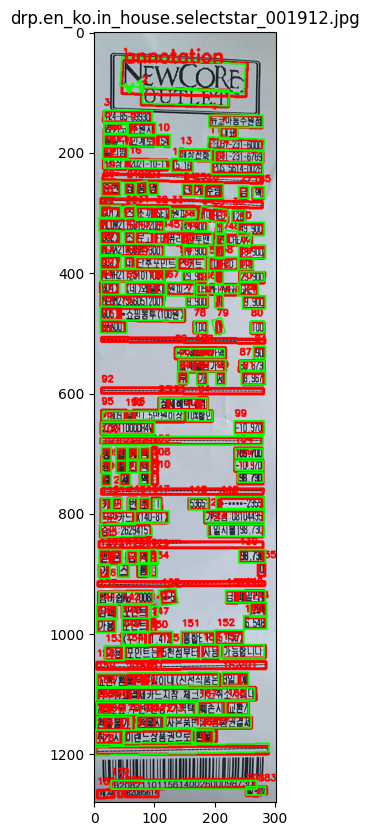

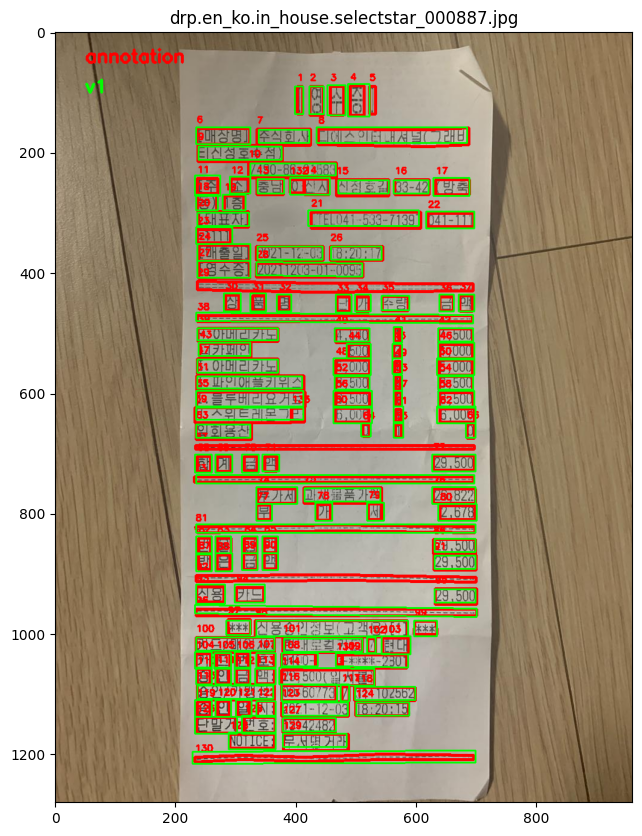

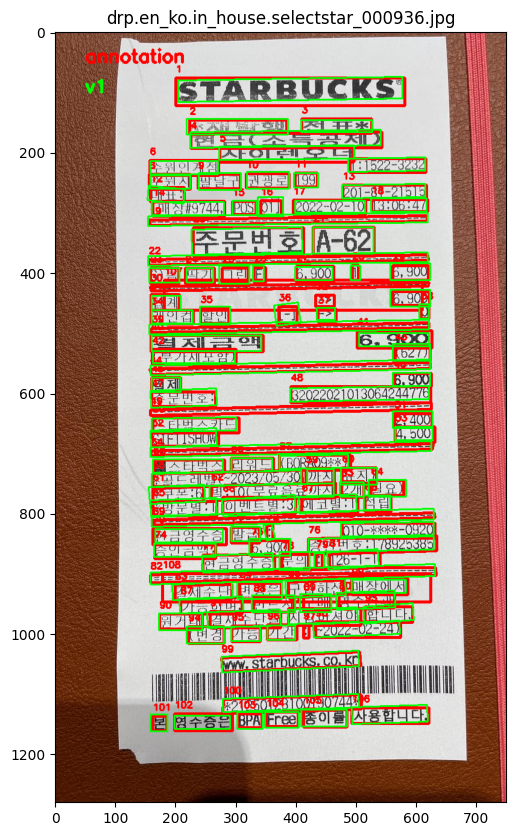

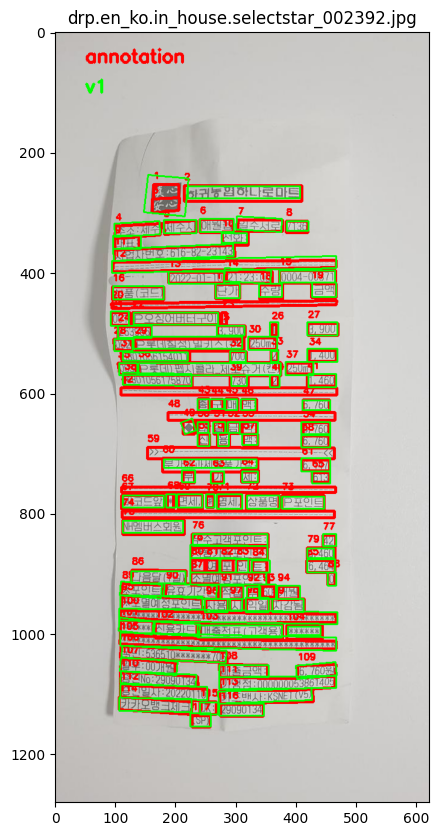

In [6]:
for i in range(50):
    print_bbox(img_list[i])

In [ ]:
for i in range(50):
    print_bbox(img_list[i])